# libraries

In [1]:

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx

from pm4py.objects.conversion.log import converter as log_converter
from pm4py.objects.log.util import dataframe_utils
from pm4py.algo.discovery.dfg import algorithm as dfg_algorithm
from pm4py.visualization.dfg import visualizer as dfg_visualization
from pm4py.util import constants
from pm4py.util import xes_constants as xes
from matplotlib.lines import Line2D
from datetime import datetime
import matplotlib.colors as mcolors
import colorsys
from matplotlib.patches import FancyArrowPatch

In [2]:
df_2017 = pd.read_csv('clean_BPI_2017.csv')
df_2012 = pd.read_csv('clean_BPI_2012.csv')

/var/folders/x_/q8m53n9s7qj76786p5830ldh0000gn/T/ipykernel_37648/923996830.py:1: DtypeWarning: Columns (14,16) have mixed types. Specify dtype option on import or set low_memory=False.
  df_2017 = pd.read_csv('clean_BPI_2017.csv')


# process mining plots for 2012

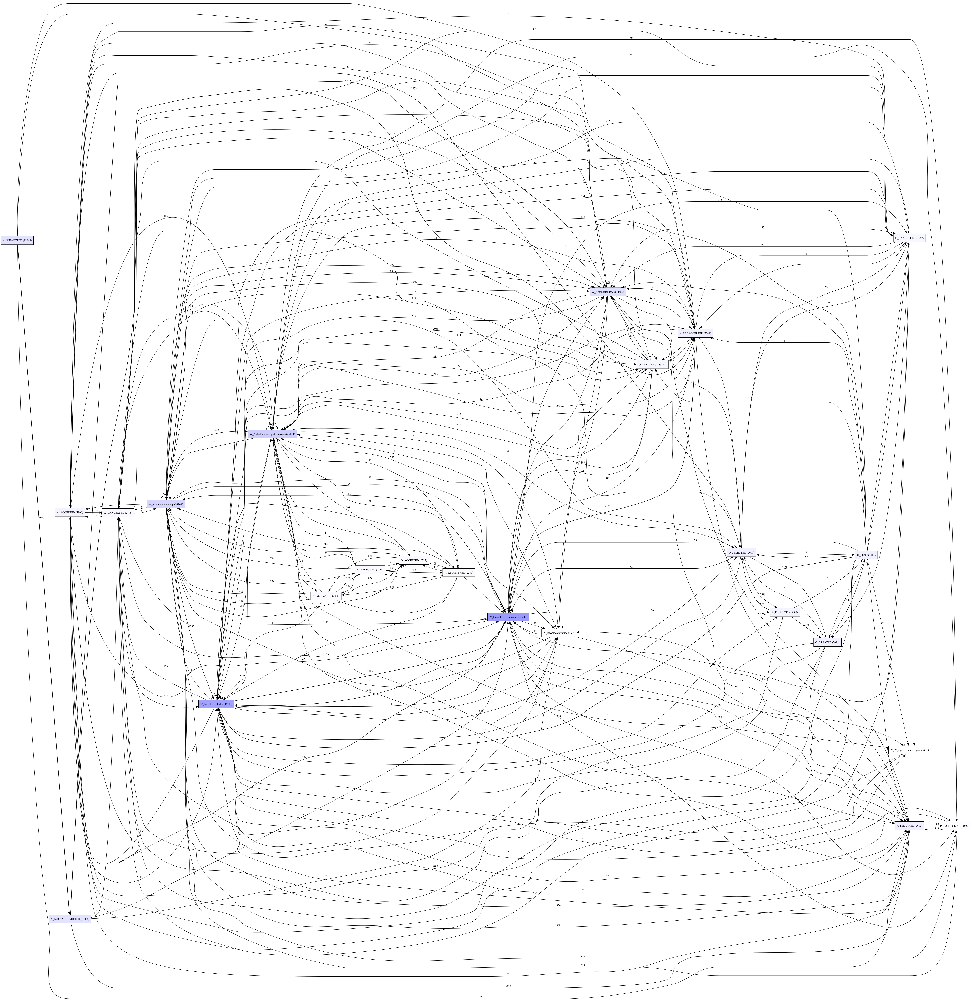

In [3]:
# Convert the DataFrame to an event log
log = dataframe_utils.convert_timestamp_columns_in_df(df_2012)
log = log_converter.apply(log)

# Discover a directly-follows graph
dfg = dfg_algorithm.apply(log)

# Visualize the graph
gviz = dfg_visualization.apply(dfg, log=log, variant=dfg_visualization.Variants.FREQUENCY)
dfg_visualization.view(gviz)


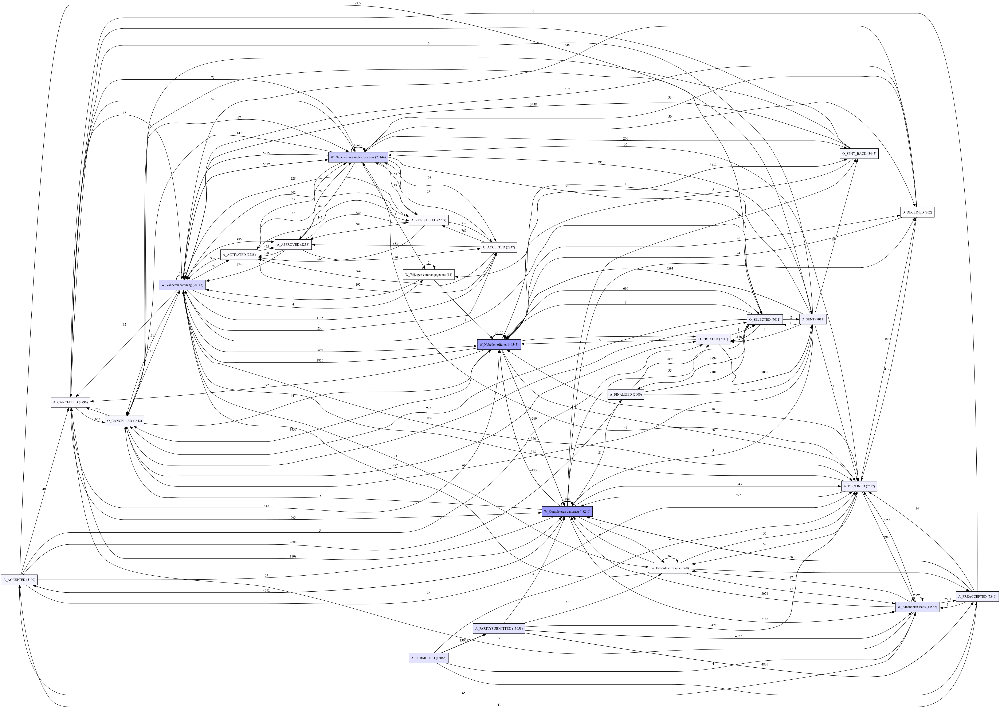

In [4]:
# Correctly rename the columns to conform to pm4py standards
df_2012.rename(columns={'Case ID': constants.CASE_CONCEPT_NAME,
                   'Activity': xes.DEFAULT_NAME_KEY,
                   'Complete Timestamp': xes.DEFAULT_TIMESTAMP_KEY}, inplace=True)

# Convert the timestamp column to datetime
df_2012[xes.DEFAULT_TIMESTAMP_KEY] = pd.to_datetime(df_2012[xes.DEFAULT_TIMESTAMP_KEY])

# Sort the dataframe by case ID and timestamp to ensure correct sequence of events
df_2012 = dataframe_utils.convert_timestamp_columns_in_df(df_2012)
df_2012.sort_values(by=[constants.CASE_CONCEPT_NAME, xes.DEFAULT_TIMESTAMP_KEY], inplace=True)

# Convert the dataframe to an event log
log = log_converter.apply(df_2012)

# Discover a directly-follows graph
dfg = dfg_algorithm.apply(log, variant=dfg_algorithm.Variants.FREQUENCY)

# Visualize the graph
gviz = dfg_visualization.apply(dfg, log=log, variant=dfg_visualization.Variants.FREQUENCY)
dfg_visualization.view(gviz)


# process mining for 2017

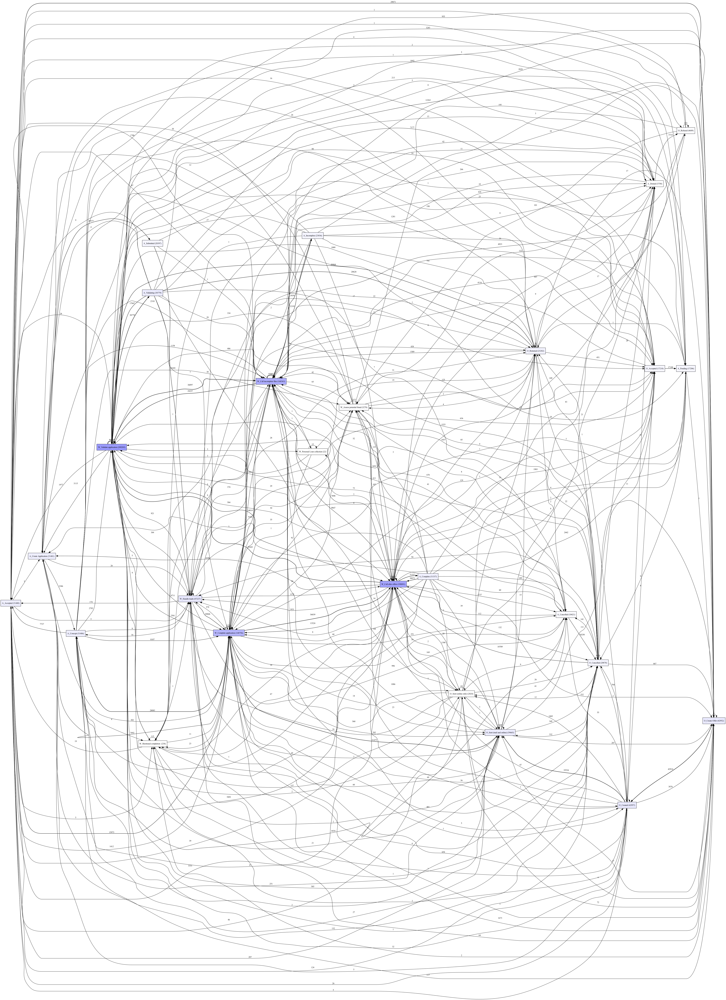

In [5]:
# Convert the DataFrame to an event log
log = dataframe_utils.convert_timestamp_columns_in_df(df_2017)
log = log_converter.apply(log)

# Discover a directly-follows graph
dfg = dfg_algorithm.apply(log)

# Visualize the graph
gviz = dfg_visualization.apply(dfg, log=log, variant=dfg_visualization.Variants.FREQUENCY)
dfg_visualization.view(gviz)


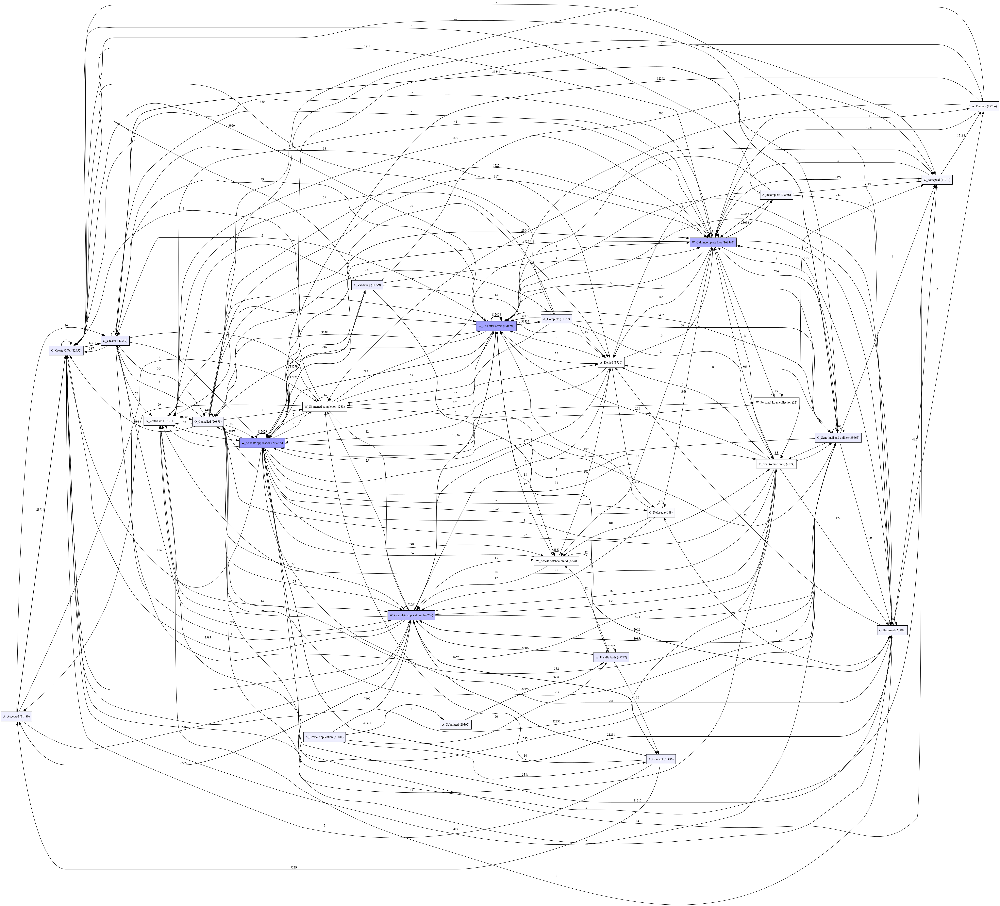

In [6]:
# Correctly rename the columns to conform to pm4py standards
df_2017.rename(columns={'Case ID': constants.CASE_CONCEPT_NAME,
                   'Activity': xes.DEFAULT_NAME_KEY,
                   'Complete Timestamp': xes.DEFAULT_TIMESTAMP_KEY}, inplace=True)

# Convert the timestamp column to datetime
df_2017[xes.DEFAULT_TIMESTAMP_KEY] = pd.to_datetime(df_2017[xes.DEFAULT_TIMESTAMP_KEY])

# Sort the dataframe by case ID and timestamp to ensure correct sequence of events
df_2017 = dataframe_utils.convert_timestamp_columns_in_df(df_2017)
df_2017.sort_values(by=[constants.CASE_CONCEPT_NAME, xes.DEFAULT_TIMESTAMP_KEY], inplace=True)

# Convert the dataframe to an event log
log = log_converter.apply(df_2017)

# Discover a directly-follows graph
dfg = dfg_algorithm.apply(log, variant=dfg_algorithm.Variants.FREQUENCY)

# Visualize the graph
gviz = dfg_visualization.apply(dfg, log=log, variant=dfg_visualization.Variants.FREQUENCY)
dfg_visualization.view(gviz)


# network plots for 2012

 ### improved network

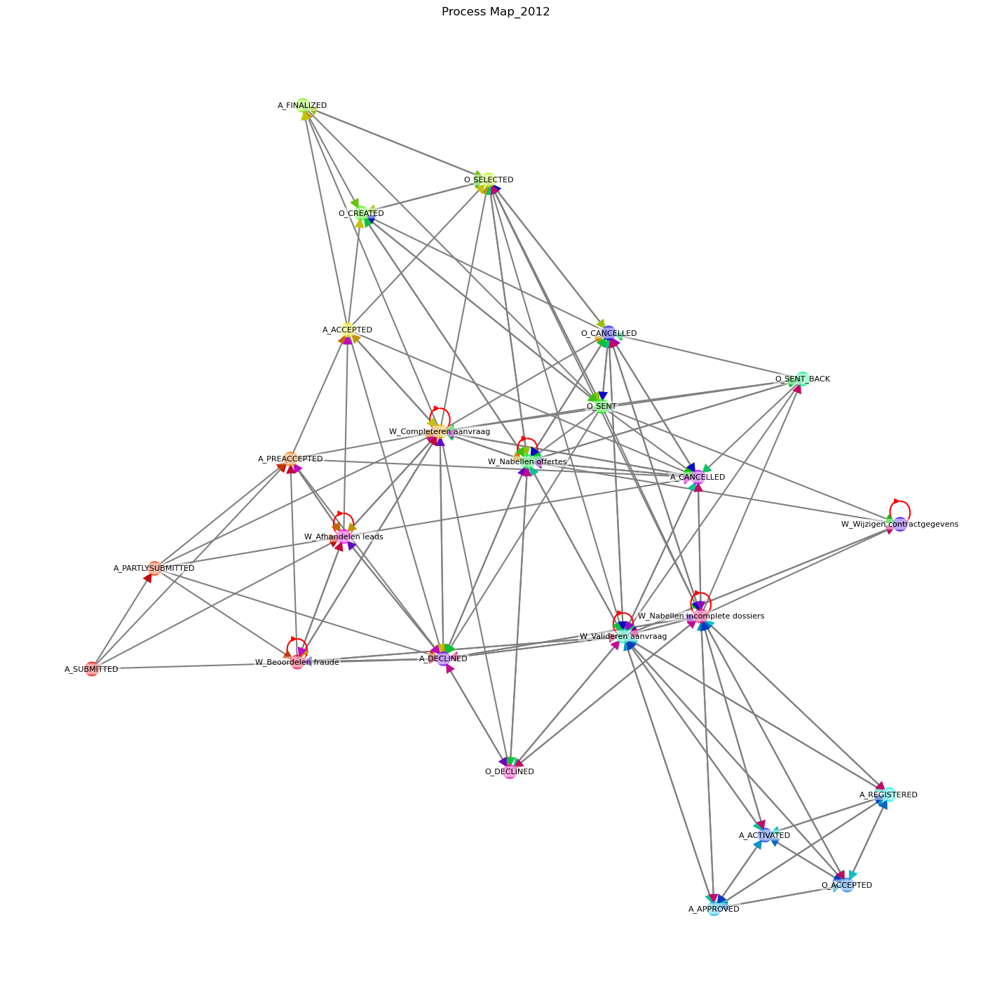

In [7]:
# Sort by case_id and timestamp
df_2012.sort_values(by=['case:concept:name', 'time:timestamp'], inplace=True)

# Create a directed graph
G = nx.DiGraph()

# Add edges for transitions between activities
for i in range(1, len(df_2012)):
    if df_2012.iloc[i]['case:concept:name'] == df_2012.iloc[i - 1]['case:concept:name']:
        G.add_edge(df_2012.iloc[i - 1]['concept:name'], df_2012.iloc[i]['concept:name'])

def get_distinct_colors(n):
    colors = []
    for i in range(n):
        hue = i / n
        lightness = 0.5  
        saturation = 0.9  
        rgb_color = colorsys.hls_to_rgb(hue, lightness, saturation)
        colors.append(rgb_color)
    return colors

# Generate distinct colors for each node
node_colors_list = get_distinct_colors(len(G.nodes()))

# Assign a unique color to each node
node_colors = {node: node_colors_list[i] for i, node in enumerate(G.nodes())}

# Create positions for the nodes in the graph
pos = nx.spring_layout(G, seed=42)  # For consistent layout

# Function to draw custom arrows for non-self-loop edges
def draw_custom_arrows(G, pos, ax, edge_list, arrow_size=15):
    for edge in edge_list:
        if edge[0] != edge[1]:  # Check if it's not a self-loop
            start, end = pos[edge[0]], pos[edge[1]]
            # Use a slightly darker shade of the node's color for the arrow
            arrow_color = colorsys.rgb_to_hsv(*node_colors[edge[0]])
            arrow_color = colorsys.hsv_to_rgb(arrow_color[0], arrow_color[1], max(arrow_color[2] * 0.8, 0))
            arrow = FancyArrowPatch(start, end, arrowstyle='-|>', color=arrow_color,
                                    mutation_scale=arrow_size, shrinkA=5, shrinkB=5, linewidth=0)
            ax.add_patch(arrow)

# Draw the graph
plt.figure(figsize=(18, 18))
ax = plt.gca()

# Draw nodes with assigned colors
nx.draw_networkx_nodes(G, pos, node_size=200, node_color=list(node_colors.values()), alpha=0.7)

# Draw all edges in grey without arrows
nx.draw_networkx_edges(G, pos, edgelist=[e for e in G.edges() if e[0] != e[1]], width=1.5, edge_color='grey', arrows=False)

# Draw self-loop edges in red with arrows
nx.draw_networkx_edges(G, pos, edgelist=[e for e in G.edges() if e[0] == e[1]], width=1.5, edge_color='red', arrows=True, arrowstyle='-|>', connectionstyle='arc3,rad=0.1')

# Draw custom arrows for non-self-loop edges using a darker shade of the node's color
draw_custom_arrows(G, pos, ax, [e for e in G.edges() if e[0] != e[1]], arrow_size=25)

# Draw node labels with improved readability
for node, (x, y) in pos.items():
    plt.text(x, y, node, fontsize=8, ha='center', va='center', 
             bbox=dict(facecolor='white', alpha=0.5, edgecolor='none', boxstyle='round,pad=0.2'))

plt.title("Process Map_2012")
plt.axis("off")
plt.show()


 ### improved network

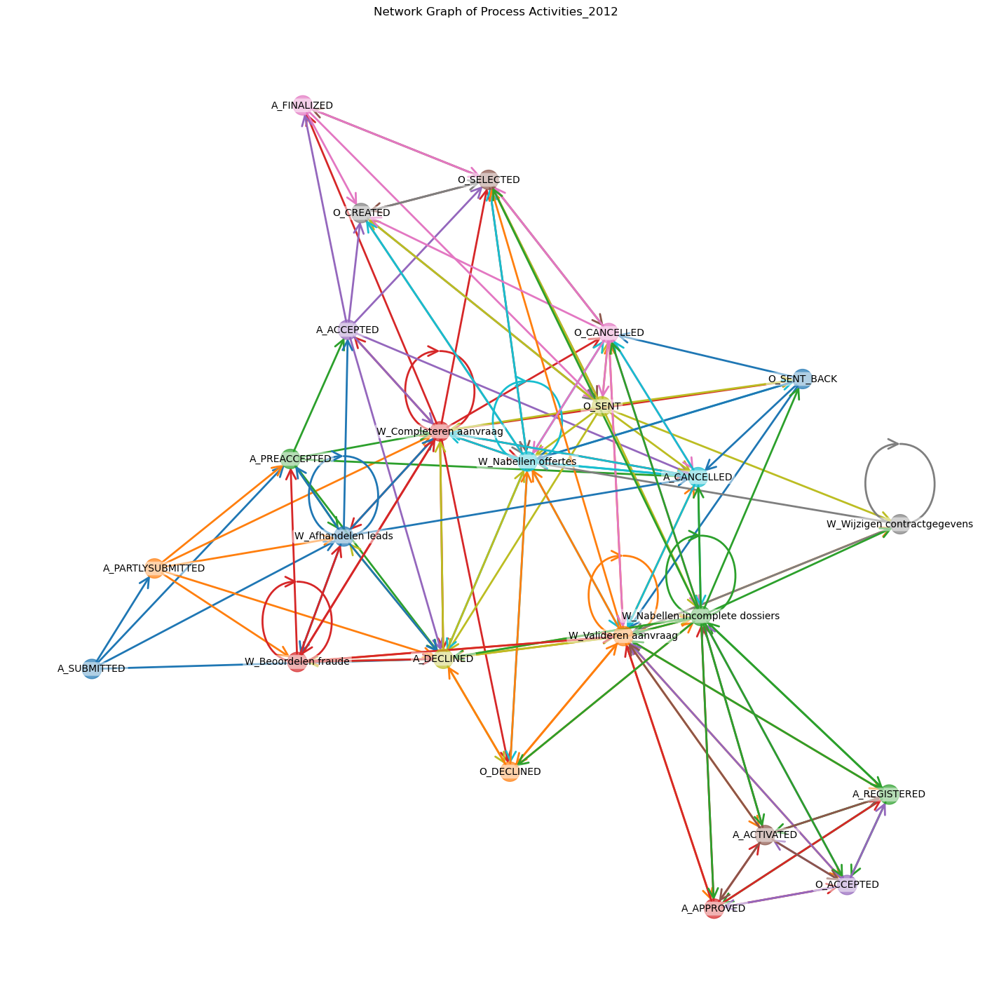

In [8]:
# Create a directed graph
G = nx.DiGraph()

# Add edges for transitions between activities for each case
last_activity = {}
for index, row in df_2012.iterrows():
    case_id = row['case:concept:name']
    activity = row['concept:name']
    if case_id in last_activity:
        G.add_edge(last_activity[case_id], activity)
    last_activity[case_id] = activity

# Assign a unique color to each node based on TABLEAU_COLORS
colors = list(mcolors.TABLEAU_COLORS.values())  # Using .values() to get the actual color strings
node_colors = {node: colors[i % len(colors)] for i, node in enumerate(G.nodes())}

# Prepare a list of edge colors based on the source node color
edge_colors = [node_colors[edge[0]] for edge in G.edges()]

# Calculate positions for each node
pos = nx.spring_layout(G, seed=42)  # Seed for reproducible layout

# Draw the graph
plt.figure(figsize=(18, 18))

# Draw nodes with assigned colors
nx.draw_networkx_nodes(G, pos, node_size=400, node_color=list(node_colors.values()), alpha=0.7)

# Draw edges with colors based on the source node
nx.draw_networkx_edges(G, pos, edge_color=edge_colors, width=2, arrowsize=25, arrowstyle="->")

# Draw node labels with improved readability
for node, (x, y) in pos.items():
    plt.text(x, y, node, fontsize=10, ha='center', va='center', 
             bbox=dict(facecolor='white', alpha=0.5, edgecolor='none', boxstyle='round,pad=0.2'))

plt.title("Network Graph of Process Activities_2012")
plt.axis("off")
plt.show()


# network plots for 2017

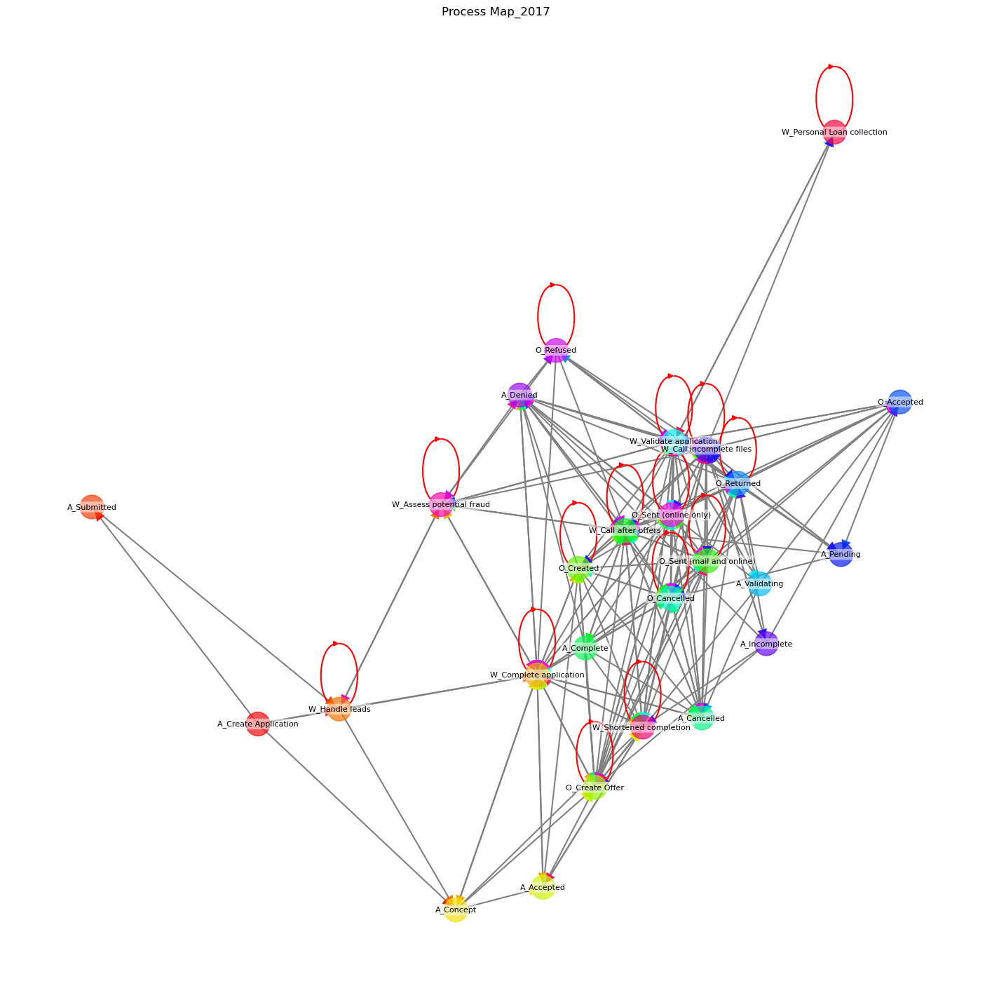

In [9]:
# Sort by case_id and timestamp
df_2017.sort_values(by=['case:concept:name', 'time:timestamp'], inplace=True)

# Create a directed graph
G = nx.DiGraph()

# Add edges for transitions between activities
for i in range(1, len(df_2017)):
    if df_2017.iloc[i]['case:concept:name'] == df_2017.iloc[i - 1]['case:concept:name']:
        G.add_edge(df_2017.iloc[i - 1]['concept:name'], df_2017.iloc[i]['concept:name'])

# Function to generate distinct colors
def get_distinct_colors(n):
    colors = []
    for i in range(n):
        hue = i / n
        lightness = 0.5
        saturation = 0.9
        rgb_color = colorsys.hls_to_rgb(hue, lightness, saturation)
        colors.append(rgb_color)
    return colors

# Generate distinct colors for each node
node_colors_list = get_distinct_colors(len(G.nodes()))

# Assign a unique color to each node
node_colors = {node: node_colors_list[i] for i, node in enumerate(G.nodes())}

# Function to draw custom arrows for non-self-loop edges
def draw_custom_arrows(G, pos, ax, edge_list, arrow_size=15):
    for edge in edge_list:
        if edge[0] != edge[1]:  # Check if it's not a self-loop
            start, end = pos[edge[0]], pos[edge[1]]
            edge_color = node_colors[edge[0]]  # Color from the source node
            arrow = FancyArrowPatch(start, end, arrowstyle='-|>', color=edge_color,
                                    mutation_scale=arrow_size, shrinkA=5, shrinkB=5, linewidth=0)
            ax.add_patch(arrow)

# Create positions for the nodes in the graph
pos = nx.spring_layout(G, seed=42)  # For consistent layout

# Draw the graph
plt.figure(figsize=(18, 18))
ax = plt.gca()

# Draw nodes with assigned colors
nx.draw_networkx_nodes(G, pos, node_size=600, node_color=list(node_colors.values()), alpha=0.7)

# Draw edges in grey without arrows
nx.draw_networkx_edges(G, pos, edgelist=[e for e in G.edges() if e[0] != e[1]], width=1.5, edge_color='grey', arrows=False)

# Draw self-loop edges in red with arrows
nx.draw_networkx_edges(G, pos, edgelist=[e for e in G.edges() if e[0] == e[1]], width=1.5, edge_color='red', arrows=True, arrowstyle='-|>', connectionstyle='arc3,rad=0.1')

# Draw custom arrows for non-self-loop edges using the source node's color
draw_custom_arrows(G, pos, ax, [e for e in G.edges() if e[0] != e[1]], arrow_size=25)

# Draw node labels with improved readability
for node, (x, y) in pos.items():
    plt.text(x, y, node, fontsize=8, ha='center', va='center', 
             bbox=dict(facecolor='white', alpha=0.5, edgecolor='none', boxstyle='round,pad=0.2'))

plt.title("Process Map_2017")
plt.axis("off")
plt.show()


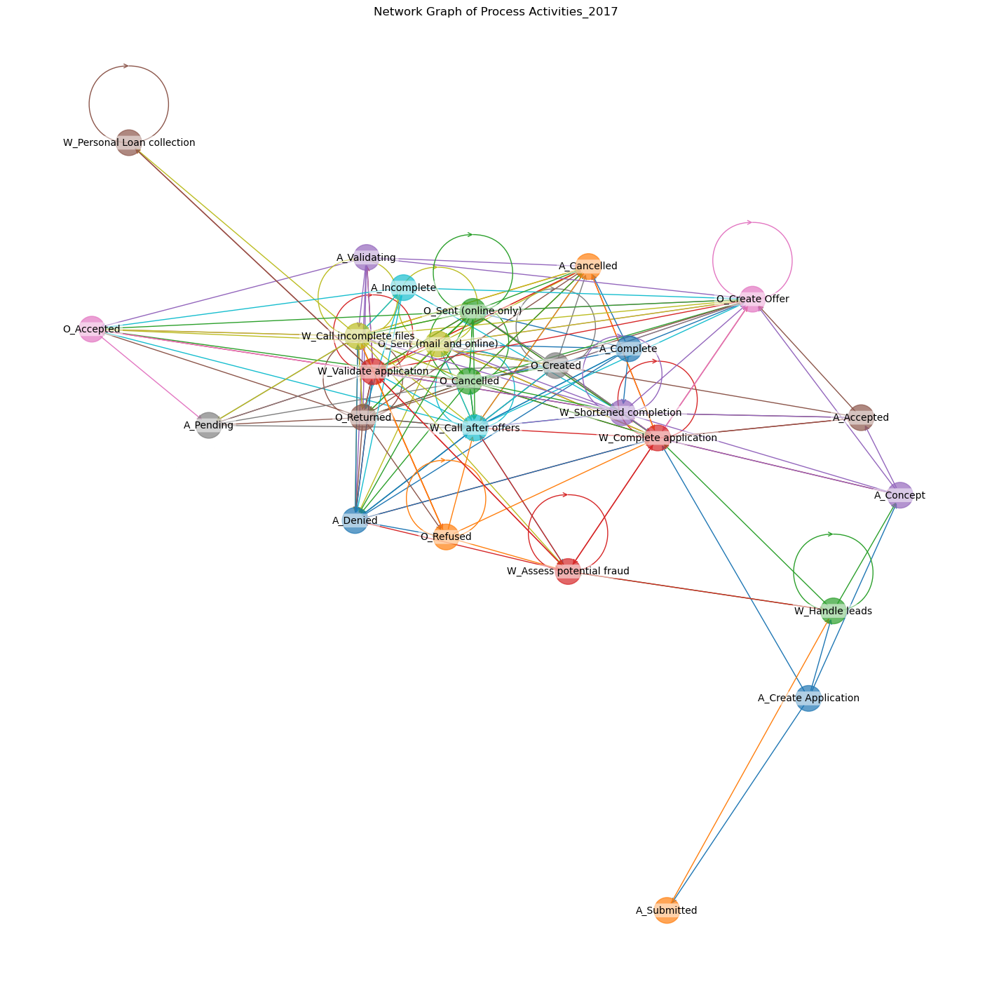

In [10]:
# Assign a unique color to each node
colors = list(mcolors.TABLEAU_COLORS)  # This is a list of color names
node_colors = {node: colors[i % len(colors)] for i, node in enumerate(G.nodes())}

# Prepare a list of edge colors based on the source node color
edge_colors = [node_colors[edge[0]] for edge in G.edges()]

# Draw the graph
plt.figure(figsize=(18, 18))
pos = nx.spring_layout(G) 

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_size=700, node_color=list(node_colors.values()), alpha=0.7)

# Draw edges with colors based on the source node
nx.draw_networkx_edges(G, pos, edge_color=edge_colors, arrowstyle="->", arrowsize=10)

# Draw node labels with improved readability
for node, (x, y) in pos.items():
    plt.text(x, y, node, fontsize=10, ha='center', va='center', 
             bbox=dict(facecolor='white', alpha=0.5, edgecolor='none', boxstyle='round,pad=0.2'))

plt.title("Network Graph of Process Activities_2017")
plt.axis("off")
plt.show()


 ### nick's network 2012

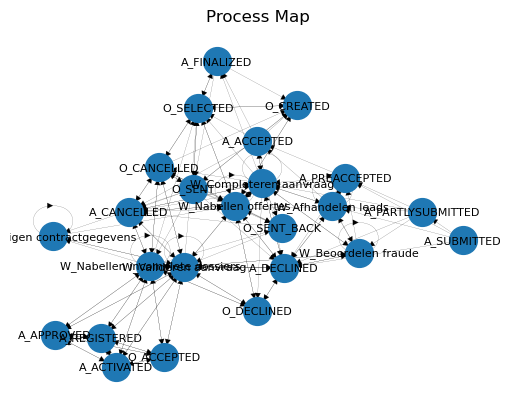

In [11]:
# Sort by case_id and timestamp
df_2012.sort_values(by=['case:concept:name', 'time:timestamp'], inplace=True)

# Create a directed graph
G = nx.DiGraph()

# Add edges for transitions between activities
for i in range(1, len(df_2012)):
    if df_2012.iloc[i]['case:concept:name'] == df_2012.iloc[i - 1]['case:concept:name']:
        G.add_edge(df_2012.iloc[i - 1]['concept:name'], df_2012.iloc[i]['concept:name'])

# Draw the graph
pos = nx.spring_layout(G)
nx.draw_networkx_nodes(G, pos, node_size=400)
nx.draw_networkx_edges(G, pos, width=0.1)
nx.draw_networkx_labels(G, pos, font_size=8, font_family="sans-serif")
plt.title("Process Map")
plt.axis("off")
plt.show()

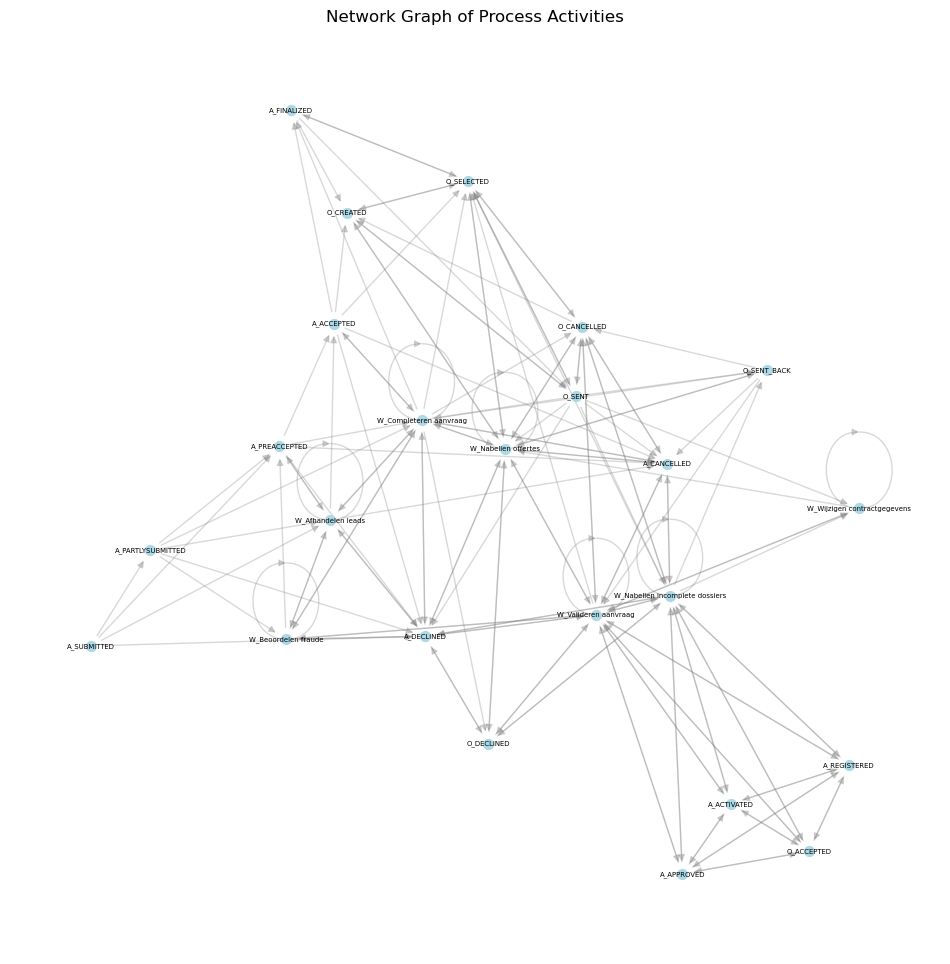

In [12]:
# Create a directed graph
G = nx.DiGraph()

# Add edges for transitions between activities for each case
# Here, we'll track the last activity to create a sequence within each case
last_activity = {}

for index, row in df_2012.iterrows():
    case_id = row['case:concept:name']
    activity = row['concept:name']
    
    # Check if the current case had a previous activity
    if case_id in last_activity:
        # Add edge from last activity to current activity for the same case
        G.add_edge(last_activity[case_id], activity)
    
    # Update the last activity for the current case
    last_activity[case_id] = activity

# Use a spring layout to visualize the graph, attempting to reflect some hierarchy or sequence
pos = nx.spring_layout(G, seed=42)  # Seed for reproducible layout

# Drawing the graph
plt.figure(figsize=(12, 12))
nx.draw_networkx_nodes(G, pos, node_size=50, node_color="lightblue")
nx.draw_networkx_edges(G, pos, alpha=0.3, edge_color="gray")
nx.draw_networkx_labels(G, pos, font_size=5, font_family="sans-serif")

plt.title("Network Graph of Process Activities")
plt.axis("off")  # Turn off the axis
plt.show()